### The Location Attributes

We will be using a multi-modal-graph network for our location attributes. This way we are meassuring accessebilty in 
terms of the whole transport network. 



Documentations:

- [UrbanAccess](https://udst.github.io/urbanaccess/installation.html)
- [Pandana](http://udst.github.io/pandana/)


Hierfür wird für jedes AirBnB die Entfernung in Minuten zum fünft-nähesten Amenity (Cafe, Pub, Restaurant oder Supermarkt) gemessen. Das Attribut berücksichtigt neben Gehminuten auch Pendlerzeiten. Hierfür wird Pandana in Kombination mit UrbanAccess verwendet. Urban Access ermöglicht es ein Graphen-Netzwerk zuerstellen, in dem ein Pedestrian (Basierend auf OSM-Daten) und ein Pendler-Netzwerk (Basierend auf den GTFS-Feeds von Berlin) kombiniert werden. Auf Basis dieses Graphen, kann anschließend mit Hilfe von Pandana die Erreichbarkeitsanalyse durchgeführt werden.

In [1]:
# Import all important Modules
%matplotlib inline

import pandas as pd
import matplotlib.pyplot as plt
import os
from collections import Counter
import geopandas as gpd
import numpy as np

import pandana as pdna
import time
import tkinter

import urbanaccess as ua
from urbanaccess.config import settings
from urbanaccess.gtfsfeeds import feeds
from urbanaccess import gtfsfeeds
from urbanaccess.gtfs.gtfsfeeds_dataframe import gtfsfeeds_dfs
from urbanaccess.network import ua_network, load_network
from mpl_toolkits.basemap import Basemap

In [9]:
# Add GTFS feeds from berlin
feeds.to_dict()
feeds.add_feed(add_dict={'vbb': 'https://www.vbb.de/media/download/2029'})
gtfsfeeds.download()

ValueError: vbb passed in add_dict already exists in gtfs_feeds. Only unique keys are allowed to be added.

In [10]:
# load feeds
bbox = (13.08835, 52.33826, 13.76116, 52.67551)
bbox_mitte = (13.296857,52.472924,13.462687,52.570473)


validation = True
verbose = True
remove_stops_outsidebbox = True
append_definitions = True


loaded_feeds = ua.gtfs.load.gtfsfeed_to_df(gtfsfeed_path=None,
                                           validation=validation,
                                           verbose=verbose,
                                           bbox=bbox,
                                           remove_stops_outsidebbox=remove_stops_outsidebbox,
                                           append_definitions=append_definitions)

GTFS text file header whitespace check completed. Took 6.13 seconds
--------------------------------
Processing GTFS feed: vbb
GTFS feed: vbb, calendar_dates uses the same service_id across multiple agency_ids. This feed calendar_dates table will be modified from its original format to provide service_ids for each agency using a one to many join
GTFS feed: vbb, calendar uses the same service_id across multiple agency_ids. This feed calendar table will be modified from its original format to provide service_ids for each agency using a one to many join
GTFS feed: vbb, stops uses the same stop_id across multiple agency_ids. This feed stops table will be modified from its original format to provide stop_ids for each agency using a one to many join
agency.txt agency_name column has more than one agency name listed. Unique agency id was assigned using the agency id and associated agency name.
Unique agency id operation complete. Took 77.76 seconds
Unique GTFS feed id operation complete. Took

Nun muss der Zeitpunkt gewählt werden, für welchen die Verbidungen im Pendler-Netzwerk genutzt werden können. 
Hier wurde Montag 07:00 - 10:00 gewählt, da an einem Wochentag mitten im Berufsverkehr wohl die meisten Verbindungen zur Verfügung stehen

In [11]:
ua.gtfs.network.create_transit_net(gtfsfeeds_dfs=loaded_feeds,
                                   day='monday',
                                   timerange=['07:00:00', '10:00:00'],
                                   calendar_dates_lookup=None)

Using calendar to extract service_ids to select trips.
901 service_ids were extracted from calendar
61,942 trip(s) 26.11 percent of 237,198 total trip records were found in calendar for GTFS feed(s): ['vbb']
NOTE: If you expected more trips to have been extracted and your GTFS feed(s) have a calendar_dates file, consider utilizing the calendar_dates_lookup parameter in order to add additional trips based on information inside of calendar_dates. This should only be done if you know the corresponding GTFS feed is using calendar_dates instead of calendar to specify service_ids. When in doubt do not use the calendar_dates_lookup parameter.
61,942 of 237,198 total trips were extracted representing calendar day: monday. Took 0.60 seconds
There are no departure time records missing from trips following monday schedule. There are no records to interpolate.
Difference between stop times has been successfully calculated. Took 14.94 seconds
Stop times from 07:00:00 to 10:00:00 successfully select

Nun zum Pedestrian-Network, hierfür wird das Straßennetzwerk von OSM benutzt

In [12]:
urbanaccess_net = ua.network.ua_network

In [13]:
nodes, edges = ua.osm.load.ua_network_from_bbox(bbox=bbox,
                                                remove_lcn=True)

Requesting network data within bounding box from Overpass API in 1 request(s)
Posting to http://www.overpass-api.de/api/interpreter with timeout=180, "{'data': '[out:json][timeout:180];(way["highway"]["highway"!~"motor|proposed|construction|abandoned|platform|raceway"]["foot"!~"no"]["pedestrians"!~"no"](52.33826000,13.08835000,52.67551000,13.76116000);>;);out;'}"
Downloaded 115,013.5KB from www.overpass-api.de in 22.21 seconds
Downloaded OSM network data within bounding box from Overpass API in 1 request(s) and 24.82 seconds
Returning OSM data with 707,639 nodes and 200,739 ways...
Edge node pairs completed. Took 439.29 seconds
Returning processed graph with 264,221 nodes and 746,448 edges...
Completed OSM data download and Pandana node and edge table creation in 483.52 seconds
checking for low connectivity nodes...
653 out of 264,221 nodes (0.25 percent of total) were identified as having low connectivity and have been removed.
Completed OSM data download and graph node and edge table

In [14]:
ua.osm.network.create_osm_net(osm_edges=edges,
                              osm_nodes=nodes,
                              travel_speed_mph=3)

Created OSM network with travel time impedance using a travel speed of 3 MPH. Took 0.02 seconds


In [15]:
# combine the two
ua.network.integrate_network(urbanaccess_network=urbanaccess_net,
                             headways=False)

Loaded UrbanAccess network components comprised of:
     Transit: 9,085 nodes and 177,681 edges;
     OSM: 263,568 nodes and 744,986 edges
Connector edges between the OSM and transit network nodes successfully completed. Took 4.49 seconds
Edge and node tables formatted for Pandana with integer node ids: id_int, to_int, and from_int. Took 15.21 seconds
Network edge and node network integration completed successfully resulting in a total of 272,653 nodes and 940,837 edges:
     Transit: 9,085 nodes 177,681 edges;
     OSM: 263,568 nodes 744,986 edges; and
     OSM/Transit connector: 18,170 edges.


In [16]:
urbanaccess_net.net_edges[urbanaccess_net.net_edges['net_type'] == 'transit'].head()


,access,area,bridge,distance,est_width,from,hgv,highway,edge_id,junction,...,to,toll,tunnel,unique_agency_id,unique_route_id,unique_trip_id,weight,width,from_int,to_int
0,nan,nan,nan,NaN,nan,710009220008_odeg_ostdeutsche_eisenbahn_gmbh,nan,nan,100940043_odeg_ostdeutsche_eisenbahn_gmbh_1,nan,...,710009230001_odeg_ostdeutsche_eisenbahn_gmbh,nan,nan,odeg_ostdeutsche_eisenbahn_gmbh,16345_100_odeg_ostdeutsche_eisenbahn_gmbh,100940043_odeg_ostdeutsche_eisenbahn_gmbh,3.5,nan,1371,1372
1,nan,nan,nan,NaN,nan,710009230001_odeg_ostdeutsche_eisenbahn_gmbh,nan,nan,100940043_odeg_ostdeutsche_eisenbahn_gmbh_2,nan,...,710009053301_odeg_ostdeutsche_eisenbahn_gmbh,nan,nan,odeg_ostdeutsche_eisenbahn_gmbh,16345_100_odeg_ostdeutsche_eisenbahn_gmbh,100940043_odeg_ostdeutsche_eisenbahn_gmbh,4.8,nan,1372,1370
2,nan,nan,nan,NaN,nan,710009220008_odeg_ostdeutsche_eisenbahn_gmbh,nan,nan,100940055_odeg_ostdeutsche_eisenbahn_gmbh_1,nan,...,710009230001_odeg_ostdeutsche_eisenbahn_gmbh,nan,nan,odeg_ostdeutsche_eisenbahn_gmbh,16345_100_odeg_ostdeutsche_eisenbahn_gmbh,100940055_odeg_ostdeutsche_eisenbahn_gmbh,3.4,nan,1371,1372
3,nan,nan,nan,NaN,nan,710009230001_odeg_ostdeutsche_eisenbahn_gmbh,nan,nan,100940055_odeg_ostdeutsche_eisenbahn_gmbh_2,nan,...,710009053301_odeg_ostdeutsche_eisenbahn_gmbh,nan,nan,odeg_ostdeutsche_eisenbahn_gmbh,16345_100_odeg_ostdeutsche_eisenbahn_gmbh,100940055_odeg_ostdeutsche_eisenbahn_gmbh,4.8,nan,1372,1370
4,nan,nan,nan,NaN,nan,710009053301_odeg_ostdeutsche_eisenbahn_gmbh,nan,nan,100940060_odeg_ostdeutsche_eisenbahn_gmbh_1,nan,...,710009230001_odeg_ostdeutsche_eisenbahn_gmbh,nan,nan,odeg_ostdeutsche_eisenbahn_gmbh,16345_100_odeg_ostdeutsche_eisenbahn_gmbh,100940060_odeg_ostdeutsche_eisenbahn_gmbh,5.2,nan,1370,1372


In [17]:
# Save to Disc
ua.network.save_network(urbanaccess_network=urbanaccess_net,
                        filename='final_Berlin.h5',
                        overwrite_key=True)

Using existing data/final_Berlin.h5 hdf5 store.
Existing edges overwritten in data/final_Berlin.h5 hdf5 store.
Using existing data/final_Berlin.h5 hdf5 store.
Existing nodes overwritten in data/final_Berlin.h5 hdf5 store.


In [3]:
# load network
# filepath to network
urbanaccess_net = ua.network.load_network(filename='final_Berlin.h5')

Successfully read store: data/final_Berlin.h5 with the following keys: ['/edges', '/nodes']
Successfully read store: data/final_Berlin.h5 with the following keys: ['/edges', '/nodes']


Figure created. Took 211.58 seconds


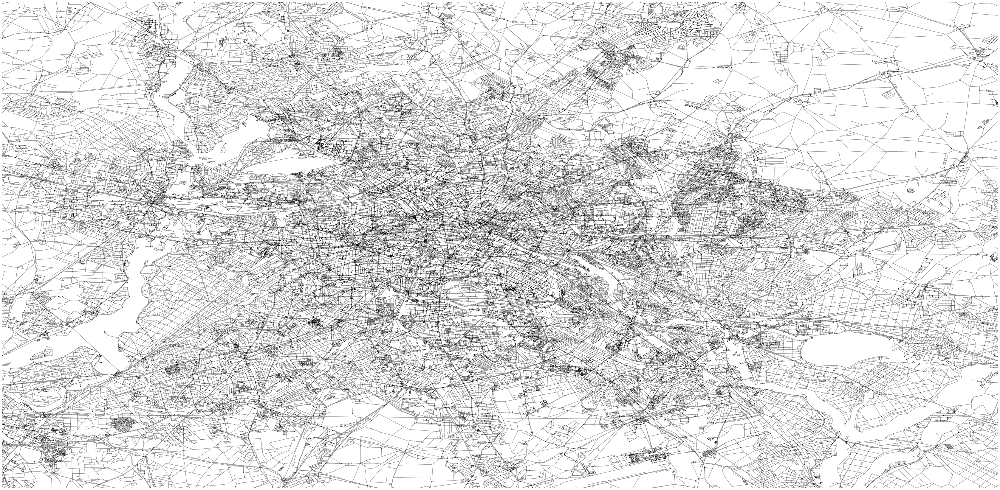

(<Figure size 4309.18x2160 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1b3782fdd0>)

In [4]:
# Plot Network
%matplotlib inline
bbox = (13.08835, 52.33826, 13.76116, 52.67551)

ua.plot.plot_net(nodes=urbanaccess_net.net_nodes,
                 edges=urbanaccess_net.net_edges,
                 bbox=bbox,
                 fig_height=30, margin=0.02,
                 edge_color='#999999', edge_linewidth=1, edge_alpha=1,
                 node_color='black', node_size=1.1, node_alpha=1, node_edgecolor='none', node_zorder=3, nodes_only=False)

In [18]:
# Calculate Headway-Times (Mean)
ua.gtfs.headways.headways(gtfsfeeds_df=loaded_feeds,
                          headway_timerange=['07:00:00','10:00:00'])

Stop times from 07:00:00 to 10:00:00 successfully selected 187,123 records out of 1,098,999 total records (17.03 percent of total). Took 0.21 seconds
Starting route stop headway calculation for 13,807 route stops...
Route stop headway calculation complete. Took 48.47 seconds
headway calculation complete. Took 51.88 seconds


In [19]:
loaded_feeds.headways.head()

,count,mean,std,min,25%,50%,75%,max,unique_stop_id,unique_route_id,node_id_route
186911,5.0,33.4,18.622567,13.0,13.0,47.0,47.0,47.0,000008010041_db_regio_ag,19045_100_db_regio_ag,000008010041_db_regio_ag_19045_100_db_regio_ag
186913,5.0,33.4,18.622567,13.0,13.0,47.0,47.0,47.0,000008010041_db_regio_ag,19045_100_db_regio_ag,000008010041_db_regio_ag_19045_100_db_regio_ag
186914,5.0,33.4,18.622567,13.0,13.0,47.0,47.0,47.0,000008010041_db_regio_ag,19045_100_db_regio_ag,000008010041_db_regio_ag_19045_100_db_regio_ag
186915,5.0,33.4,18.622567,13.0,13.0,47.0,47.0,47.0,000008010041_db_regio_ag,19045_100_db_regio_ag,000008010041_db_regio_ag_19045_100_db_regio_ag
186917,5.0,33.4,18.622567,13.0,13.0,47.0,47.0,47.0,000008010041_db_regio_ag,19045_100_db_regio_ag,000008010041_db_regio_ag_19045_100_db_regio_ag


In [20]:
# Add Headway-Times
ua.network.integrate_network(urbanaccess_network=urbanaccess_net,
                             headways=True,
                             urbanaccess_gtfsfeeds_df=loaded_feeds,
                             headway_statistic='mean')

Loaded UrbanAccess network components comprised of:
     Transit: 9,085 nodes and 177,681 edges;
     OSM: 263,568 nodes and 744,986 edges
routes successfully joined to transit nodes. Took 0.45 seconds
Connector edges between the OSM and transit network nodes successfully completed. Took 6.05 seconds
mean route stop headway will be used for pedestrian to transit edge impedance.
Headway impedance calculation completed. Took 0.22 seconds
Edge and node tables formatted for Pandana with integer node ids: id_int, to_int, and from_int. Took 19.54 seconds
Network edge and node network integration completed successfully resulting in a total of 277,367 nodes and 1,123,562 edges:
     Transit: 13,799 nodes 177,681 edges;
     OSM: 263,568 nodes 744,986 edges; and
     OSM/Transit connector: 200,895 edges.


In [21]:
# Safe Network
ua.network.save_network(urbanaccess_network=urbanaccess_net,
                        filename='final_Berlin.h5',
                        overwrite_key=True)

Using existing data/final_Berlin.h5 hdf5 store.
Existing edges overwritten in data/final_Berlin.h5 hdf5 store.
Using existing data/final_Berlin.h5 hdf5 store.
Existing nodes overwritten in data/final_Berlin.h5 hdf5 store.


Nun da das Netzwerk steht, kommen wir zur eigentlichen Analyse. Hierfür werden die zuvor aufbereiteten Listings als Dataframe geladen. Weiterhin wurden mit einem externen Script alle Amenities aus Berlin mit Key = restaurant, cafe, pub, supermarket  von OSM gezogen und hier als Dataframe geladen. 

In [2]:
# load network
ua_net = ua.network.load_network(filename='final_Berlin.h5')

Successfully read store: data/final_Berlin.h5 with the following keys: ['/edges', '/nodes']
Successfully read store: data/final_Berlin.h5 with the following keys: ['/edges', '/nodes']


In [3]:
# Import Listings
Listings_dir = r'./Berlin_Data/Berlin_cleaned.csv'
df_listings = pd.read_csv(Listings_dir)

# Import POIS
amenities_dir = r'./Berlin_Data/amenities_berlin.csv'
df_amenities = pd.read_csv(amenities_dir)

sights_dir = r'./Berlin_Data/sights_berlin.csv'
df_sights = pd.read_csv(sights_dir)

parks_dir = r'./Berlin_Data/Parks_Berlin.csv'
df_parks = pd.read_csv(parks_dir)


df_amenities['latitude']
# Separate Coordinates from coordinate column into Long and Lat
#df_amanaties[['longitude','latitude']] = df_amanaties.coordinates.str.split(",",expand=True,)

0       52.433668
1       52.413250
2       52.414142
3       52.470656
4       52.448448
          ...    
8343    52.566968
8344    52.632945
8345    52.632262
8346    52.609645
8347    52.605392
Name: latitude, Length: 8348, dtype: float64

In [4]:
# clean park, the key didn't work and the script downloaded leisure=*
# this code is very messy, remember to create a function for that
df_parks.leisure.value_counts()
to_keep = ['playground', 'pitch', 'garden', 'fitness_station', 'marina', 'picnic_table', 'park']
all_rows = df_parks['leisure'].tolist()
delete = []
delete_1 = []

for y in all_rows:
    if y not in delete:
        delete.append(y)

for x in delete:
    if x not in to_keep:
        delete_1.append(x)
    

for z in delete_1:
    indexNames = df_parks[df_parks['leisure'] == z].index
    df_parks.drop(indexNames, inplace=True)

df_parks.leisure.value_counts()


playground         1109
pitch               678
marina              139
picnic_table        126
garden               37
fitness_station      30
park                  2
Name: leisure, dtype: int64

In [5]:
# clean parks, the value didnt work and the script downloaded toursim = *
df_sights.tourism.value_counts()

keep = ['artwork', 'viewpoint', 'museum', 'attraction']
all_s = df_sights['tourism'].tolist()

dele = []
del_1 = []

for y in all_s:
    if y not in dele:
        dele.append(y)

for x in dele:
    if x not in keep:
        del_1.append(x)
        
for z in del_1:
    indexNames = df_sights[df_sights['tourism'] == z].index
    df_sights.drop(indexNames, inplace=True)

df_sights.tourism.value_counts()



artwork       753
viewpoint     152
museum        123
attraction     70
Name: tourism, dtype: int64

In [6]:
# Initialise Pandana Network
s_time = time.time()
transit_ped_net = pdna.Network(ua_net.net_nodes["x"],
                               ua_net.net_nodes["y"],
                               ua_net.net_edges["from_int"],
                               ua_net.net_edges["to_int"],
                               ua_net.net_edges[["weight"]], 
                               twoway=False)
print('Took {:,.2f} seconds'.format(time.time() - s_time))

Took 153.30 seconds


Zunächst werden die POIS(Amenities) im Netzwerk eingetragen und der nähesten Node des Netzwerkes zugeordnet

In [7]:
distance = 40
num_pois = 10
distance_parks = 10

# Set POIS from OSM-Data
transit_ped_net.set_pois('amenities', distance ,num_pois, df_amenities['longitude'], df_amenities['latitude'])
transit_ped_net.set_pois('parks', distance ,num_pois, df_parks['longitude'], df_parks['latitude'])
transit_ped_net.set_pois('sights', distance ,num_pois, df_sights['longitude'], df_sights['latitude'])

Anschließend wird für jedes Feature aus dem Dataframe Listing die näheste Node gesucht und derren ID wird als neues Attribut um DF hinzugefügt. Dies wird im Weiteren Verlauf benötigt.

In [8]:
# get Node IDS
long = df_listings['longitude']
lat = df_listings['latitude']
df_listings['node_id'] = transit_ped_net.get_node_ids(long, lat)

In [9]:
# get 5-nearest POI for sights and amenities
num_pois = 5
N_nearest_access = transit_ped_net.nearest_pois(distance=distance, category='amenities', num_pois=num_pois)
N_nearest_access_sights = transit_ped_net.nearest_pois(distance=distance, category='sights', num_pois=num_pois)

# for parks the nearest is choosen
N_nearest_access_parks = transit_ped_net.nearest_pois(distance=distance_parks, category='parks', num_pois=1)



# Create DF for requested number of POIs
Access_Score = pd.DataFrame(N_nearest_access[5])
Access_Score_sights = pd.DataFrame(N_nearest_access_sights[5])
Access_Score_parks = pd.DataFrame(N_nearest_access_parks[1])

# Rename to score
Access = Access_Score.rename(columns={5:'Score_Amenities'})
Access_sights = Access_Score_sights.rename(columns={5:'Score_Sights'})
Access_parks = Access_Score_parks.rename(columns={1:'Score_Parks'})


# get node_ids fpr POIs
df_amenities['node_id'] = transit_ped_net.get_node_ids(df_amenities['longitude'], df_amenities['latitude'])


In [10]:
Access.reset_index(level=0, inplace=True)
Access_sights.reset_index(level=0, inplace=True)
Access_parks.reset_index(level=0, inplace=True)

In [11]:
Access = Access.rename(columns={'id_int':'node_id'})
Access_sights = Access_sights.rename(columns={'id_int':'node_id'})
Access_parks = Access_parks.rename(columns={'id_int':'node_id'})

Merge die Dataframes nach node_id

In [12]:
Access.set_index('node_id',inplace=True)
Access_sights.set_index('node_id',inplace=True)
Access_parks.set_index('node_id',inplace=True)


print(Access)

         Score_Amenities
node_id                 
1                  6.950
2                  5.134
3                  5.616
4                 12.212
5                  5.012
...                  ...
277363             6.272
277364             6.595
277365            20.000
277366            20.000
277367            20.000

[277367 rows x 1 columns]


In [13]:
merged1 = pd.merge(df_listings, Access, on='node_id')



In [14]:
merged2 = pd.merge(merged1, Access_sights, on='node_id')

In [15]:
merged3 = pd.merge(merged2, Access_parks, on='node_id')

In [16]:
merged3.head()

,id,latitude,longitude,accommodates,bathrooms,bedrooms,beds,price,security_deposit,cleaning_fee,...,room_type_Shared room,bed_type_Couch,bed_type_Real Bed,cancellation_policy_flexible,cancellation_policy_moderate,cancellation_policy_strict_14_with_grace_period,node_id,Score_Amenities,Score_Sights,Score_Parks
0,2015,52.534537,13.402557,3,1.0,1.0,2.0,60.0,200.0,30.0,...,0,0,1,0,0,1,20818,2.011,10.177,3.038
1,21169657,52.534631,13.402832,2,1.0,1.0,1.0,60.0,0.0,0.0,...,0,0,1,0,1,0,20818,2.011,10.177,3.038
2,2695,52.548513,13.404553,2,1.0,1.0,1.0,17.0,0.0,0.0,...,0,0,1,1,0,0,16140,3.212,14.514,4.442
3,7044917,52.548356,13.404327,2,1.0,1.0,2.0,80.0,0.0,0.0,...,0,0,1,1,0,0,16140,3.212,14.514,4.442
4,18790213,52.548123,13.404316,6,1.0,2.0,2.0,160.0,0.0,50.0,...,0,0,1,0,1,0,16140,3.212,14.514,4.442


In [87]:
# to csv 
merged3.to_csv('Berlin_Listings_Final.csv', index=False)

In [67]:
merged.dtypes

Unnamed: 0                                                 int64
id                                                         int64
latitude                                                 float64
longitude                                                float64
accommodates                                               int64
bathrooms                                                float64
bedrooms                                                 float64
beds                                                     float64
price                                                    float64
security_deposit                                         float64
cleaning_fee                                             float64
guests_included                                            int64
extra_people                                             float64
minimum_nights                                             int64
instant_bookable                                           int64
check_in_24h             

### Access Maps

In [94]:
ua_net.net_nodes.head()

,id,net_type,x,y
id_int,,,,
1,710009220008_odeg_ostdeutsche_eisenbahn_gmbh_1...,NaN,13.098009,52.358818
2,710009230001_odeg_ostdeutsche_eisenbahn_gmbh_1...,NaN,13.122184,52.383023
3,710009053301_odeg_ostdeutsche_eisenbahn_gmbh_1...,NaN,13.179099,52.421457
4,710009029305_odeg_ostdeutsche_eisenbahn_gmbh_1...,NaN,13.141852,52.537520
5,710009029101_odeg_ostdeutsche_eisenbahn_gmbh_1...,NaN,13.197477,52.534798


#### Alle Nodes in Berlin (OSM+Transit)

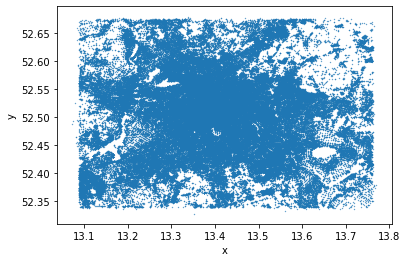

In [20]:
ua_net.net_nodes.plot(kind='scatter', x='x', y='y', s=0.1)

In [45]:
df_amenities["test"] = 1
df_amenities.head()


,latitude,longitude,altitude,geometry,@osmId,@snapshotTimestamp,amenity,shop,layer,path,node_ids,test
0,52.433668,13.422586,NaN,Point,node/276795876,2019/01/01 00:00:00,cafe,NaN,cafes,/Users/Julian/PycharmProjects/AirBnB/cafes.geo...,111217,1
1,52.413250,13.362927,NaN,Point,node/324792576,2019/01/01 00:00:00,cafe,NaN,cafes,/Users/Julian/PycharmProjects/AirBnB/cafes.geo...,175180,1
2,52.414142,13.363518,NaN,Point,node/324792579,2019/01/01 00:00:00,cafe,NaN,cafes,/Users/Julian/PycharmProjects/AirBnB/cafes.geo...,166745,1
3,52.470656,13.442952,NaN,Point,node/441878995,2019/01/01 00:00:00,cafe,NaN,cafes,/Users/Julian/PycharmProjects/AirBnB/cafes.geo...,227965,1
4,52.448448,13.384915,NaN,Point,node/442392124,2019/01/01 00:00:00,cafe,NaN,cafes,/Users/Julian/PycharmProjects/AirBnB/cafes.geo...,188894,1


In [24]:
# query for POIS within 20 Minutes
a = transit_ped_net.nearest_pois(20, "amenities", num_pois=10)
b = transit_ped_net.nearest_pois(20, "sights", num_pois=10)
c = transit_ped_net.nearest_pois(10, "parks", num_pois=10)



In [12]:
# query for POIS within 40 Minutes
d = transit_ped_net.nearest_pois(40, "amenities", num_pois=5)
e = transit_ped_net.nearest_pois(40, "sights", num_pois=5)
f = transit_ped_net.nearest_pois(40, "parks", num_pois=1)


#### Plot 5th nearest Amenitie within 20 min

(<mpl_toolkits.basemap.Basemap at 0x2c5734310>,
 <Figure size 1440x1440 with 2 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2c576a690>)

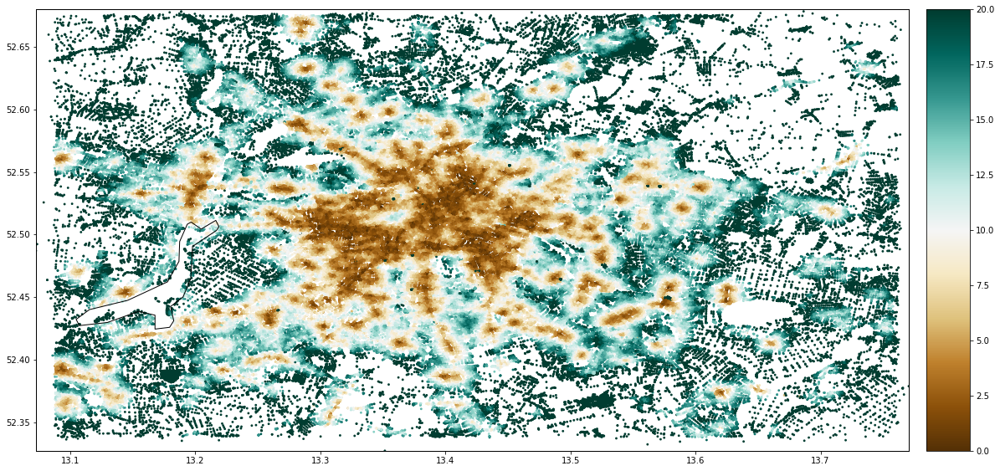

In [22]:
bbox = (13.324699,52.483276,13.454955,52.551734)
sf_bbox = [bbox[1], bbox[0], bbox[3], bbox[2]]

%matplotlib inline

transit_ped_net.plot(a[5], 
         fig_kwargs={'figsize': [20, 20]},
         bmap_kwargs={'suppress_ticks': False,
                      'resolution': 'h', 'epsg': '4326'},
         plot_kwargs={'cmap': 'BrBG', 's': 8, 'edgecolor': 'none'})

#### Plott 5th nearest sight within 20 min

(<mpl_toolkits.basemap.Basemap at 0x2bfccf990>,
 <Figure size 1440x1440 with 2 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2bfccf4d0>)

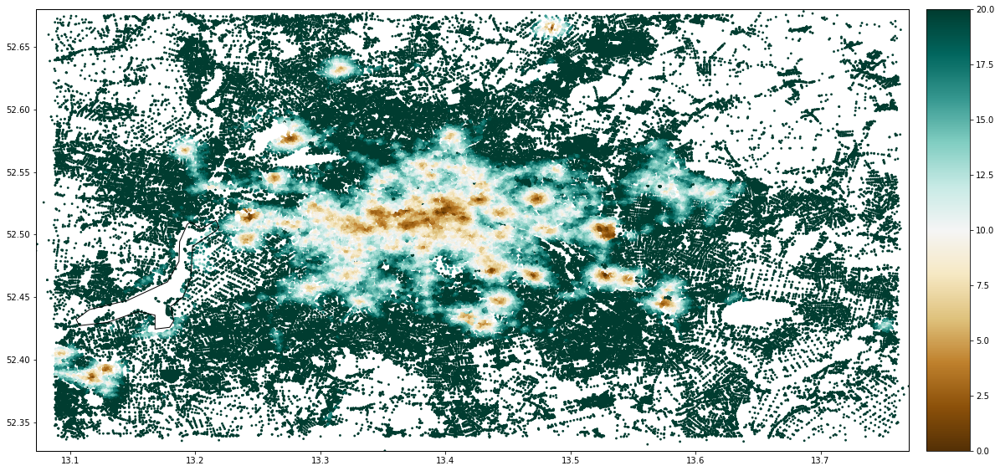

In [25]:
%matplotlib inline

transit_ped_net.plot(b[5], 
         fig_kwargs={'figsize': [20, 20]},
         bmap_kwargs={'suppress_ticks': False,
                      'resolution': 'h', 'epsg': '4326'},
         plot_kwargs={'cmap': 'BrBG', 's': 8, 'edgecolor': 'none'})

#### Plot nearest Park within 10

(<mpl_toolkits.basemap.Basemap at 0x2bfcb1390>,
 <Figure size 1440x1440 with 2 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2bfcb18d0>)

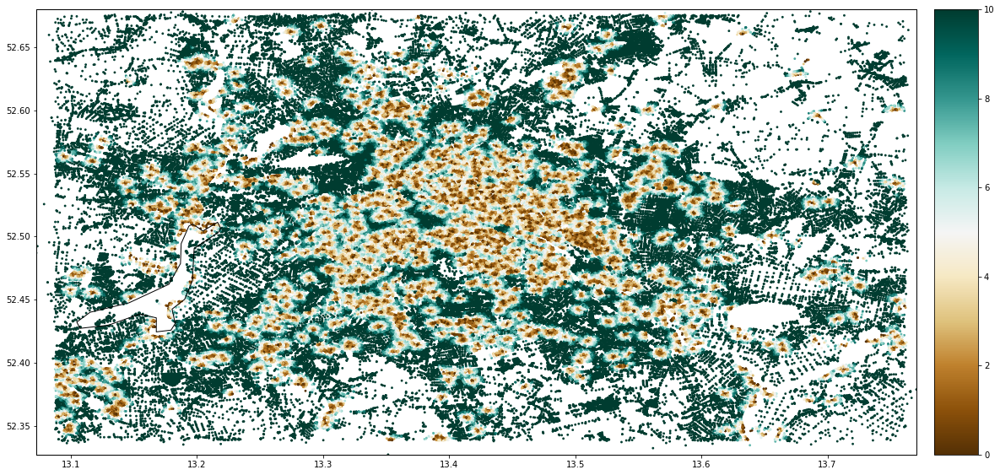

In [26]:
%matplotlib inline

transit_ped_net.plot(c[1], 
         fig_kwargs={'figsize': [20, 20]},
         bmap_kwargs={'suppress_ticks': False,
                      'resolution': 'h', 'epsg': '4326'},
         plot_kwargs={'cmap': 'BrBG', 's': 8, 'edgecolor': 'none'})

#### Plot 5th nearest Amenitie within 40 min

(<mpl_toolkits.basemap.Basemap at 0x2c398a1d0>,
 <Figure size 1440x1440 with 2 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2c395f5d0>)

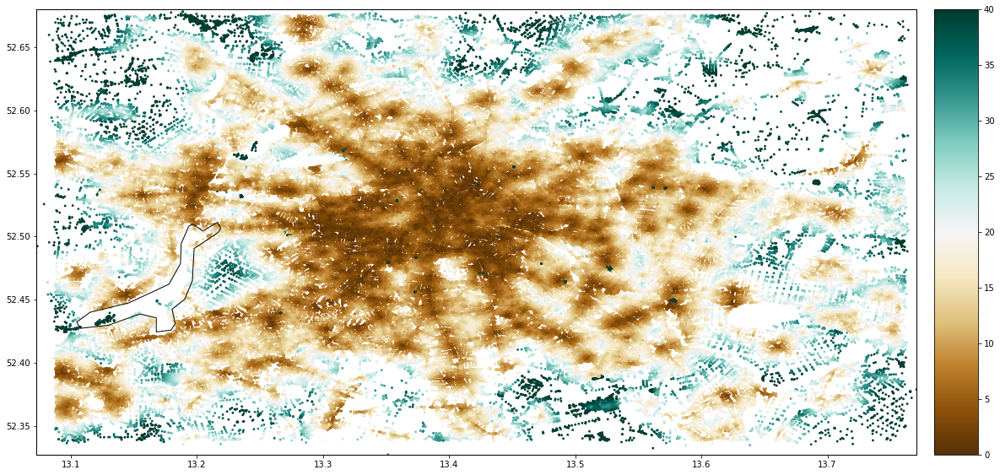

In [9]:
bbox = (13.324699,52.483276,13.454955,52.551734)
sf_bbox = [bbox[1], bbox[0], bbox[3], bbox[2]]

%matplotlib inline

transit_ped_net.plot(d[5], 
         fig_kwargs={'figsize': [20, 20]},
         bmap_kwargs={'suppress_ticks': False,
                      'resolution': 'h', 'epsg': '4326'},
         plot_kwargs={'cmap': 'BrBG', 's': 8, 'edgecolor': 'none'})

#### Plot 5th nearest Sight within 40 min

(<mpl_toolkits.basemap.Basemap at 0x2c3955190>,
 <Figure size 1440x1440 with 2 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2c3969650>)

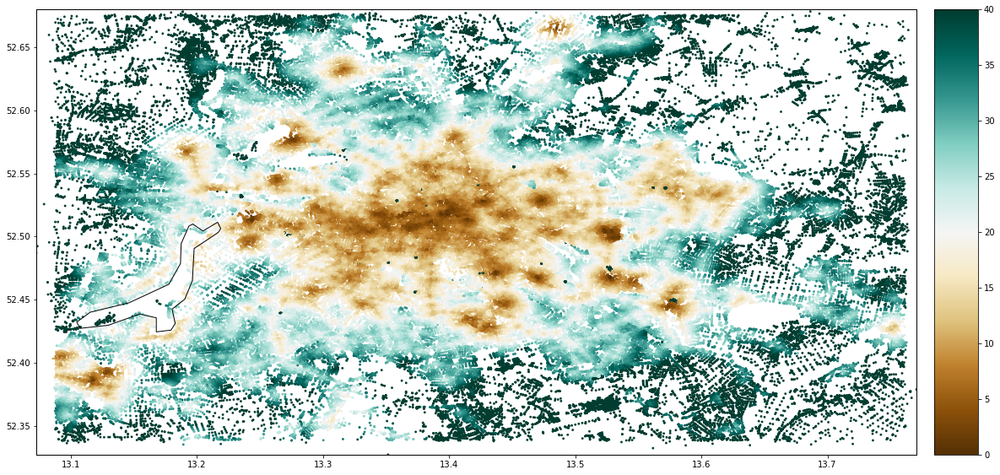

In [10]:
bbox = (13.324699,52.483276,13.454955,52.551734)
sf_bbox = [bbox[1], bbox[0], bbox[3], bbox[2]]

%matplotlib inline

transit_ped_net.plot(e[5], 
         fig_kwargs={'figsize': [20, 20]},
         bmap_kwargs={'suppress_ticks': False,
                      'resolution': 'h', 'epsg': '4326'},
         plot_kwargs={'cmap': 'BrBG', 's': 8, 'edgecolor': 'none'})

#### Plot 5th nearest Park within 40 min

(<mpl_toolkits.basemap.Basemap at 0x2c0e44c10>,
 <Figure size 1440x1440 with 2 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2c3999d50>)

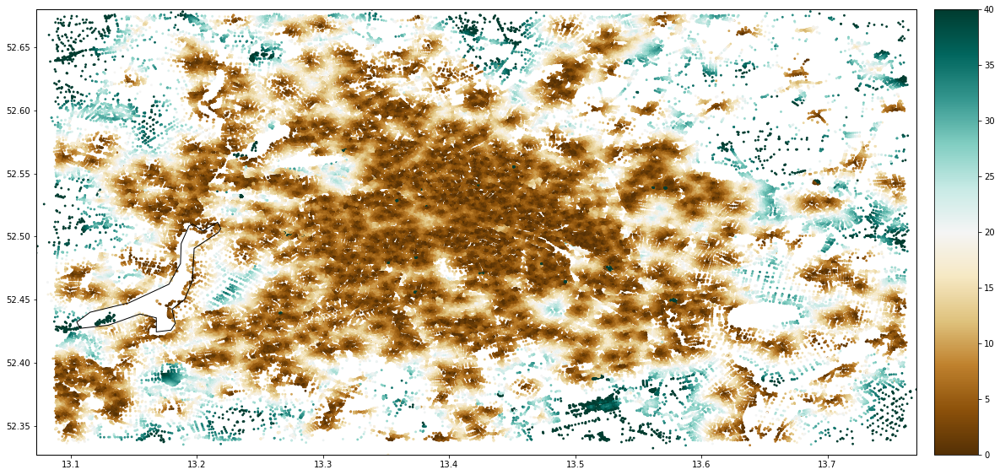

In [13]:
bbox = (13.324699,52.483276,13.454955,52.551734)
sf_bbox = [bbox[1], bbox[0], bbox[3], bbox[2]]

%matplotlib inline

transit_ped_net.plot(f[1], 
         fig_kwargs={'figsize': [20, 20]},
         bmap_kwargs={'suppress_ticks': False,
                      'resolution': 'h', 'epsg': '4326'},
         plot_kwargs={'cmap': 'BrBG', 's': 8, 'edgecolor': 'none'})

### Transit Network

Figure created. Took 41.76 seconds


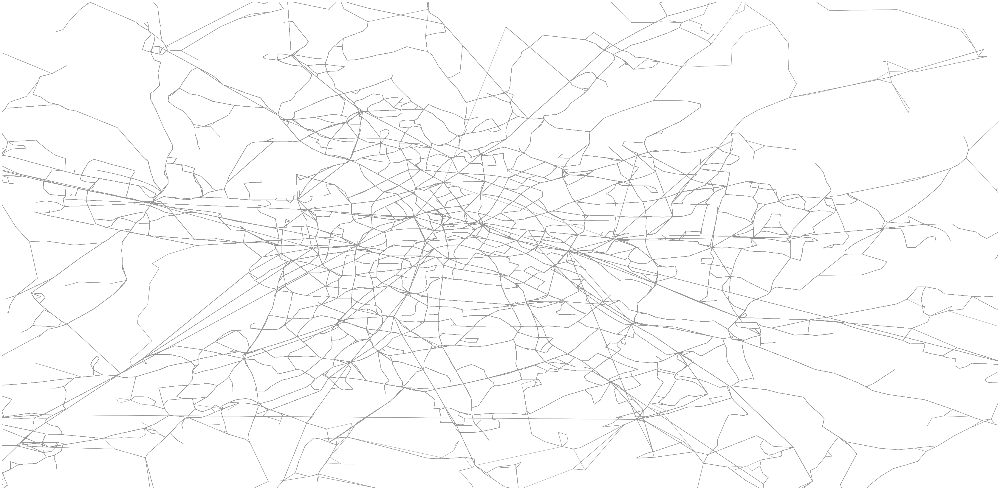

(<Figure size 4309.54x2160 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2c0e2c250>)

In [14]:
ua.plot.plot_net(nodes=ua_net.net_nodes,
                 edges=ua_net.net_edges[ua_net.net_edges['net_type']=='transit'],
                 bbox=None,
                 fig_height=30, margin=0.02,
                 edge_color='#999999', edge_linewidth=1, edge_alpha=1,
                 node_color='black', node_size=0, node_alpha=1, node_edgecolor='none', node_zorder=3, nodes_only=False)

### Pedestrian Network

Figure created. Took 181.22 seconds


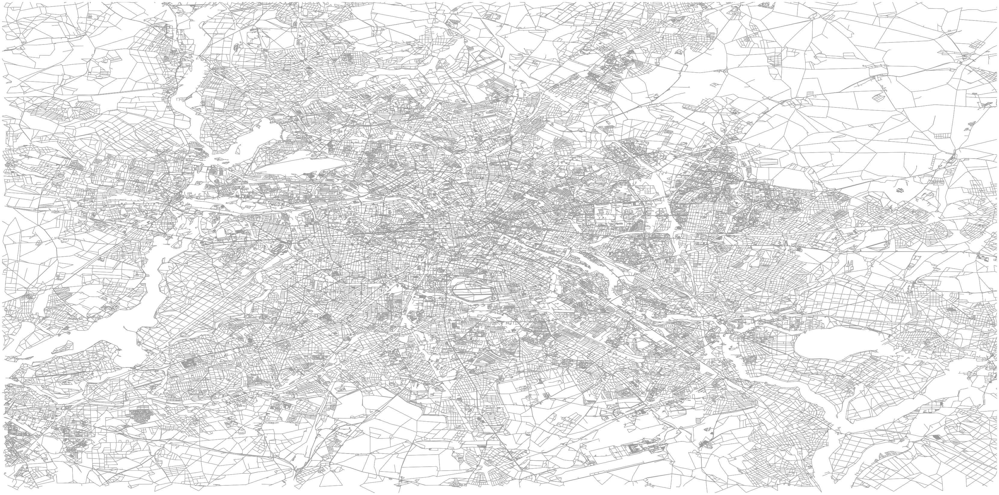

(<Figure size 4269.75x2160 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2c0e38190>)

In [15]:
ua.plot.plot_net(nodes=ua_net.net_nodes,
                 edges=ua_net.net_edges[ua_net.net_edges['net_type']=='walk'],
                 bbox=None,
                 fig_height=30, margin=0.02,
                 edge_color='#999999', edge_linewidth=1, edge_alpha=1,
                 node_color='black', node_size=0, node_alpha=1, node_edgecolor='none', node_zorder=3, nodes_only=False)

#### Nodes Only

Figure created. Took 5.74 seconds


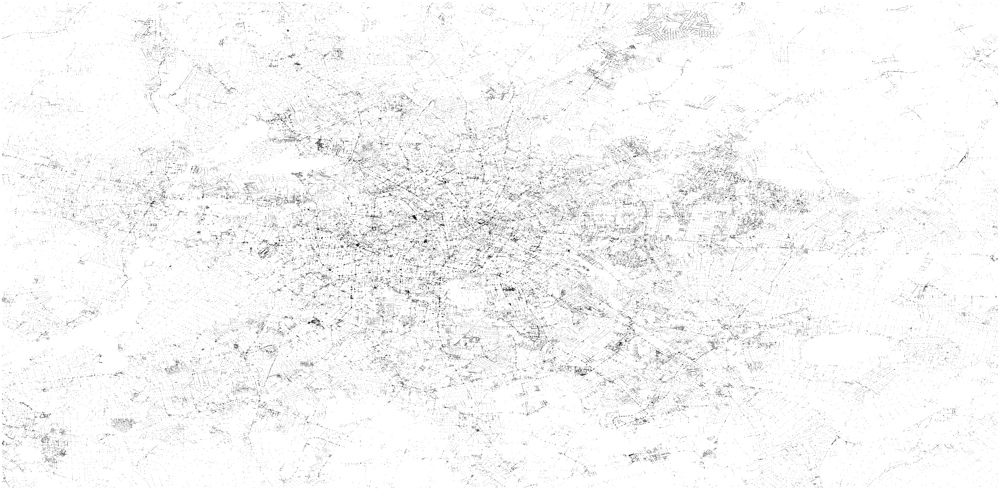

(<Figure size 4309.18x2160 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2bc3ae210>)

In [18]:
# Plot Network-Nodes
%matplotlib inline
bbox = (13.08835, 52.33826, 13.76116, 52.67551)

ua.plot.plot_net(nodes=ua_net.net_nodes,
                 edges=ua_net.net_edges,
                 bbox=bbox,
                 fig_height=30, margin=0.02,
                 edge_color='#999999', edge_linewidth=1, edge_alpha=1,
                 node_color='black', node_size=1.1, node_alpha=1, node_edgecolor='none', node_zorder=3, nodes_only=True)

#### Zoom in (Berlin-Mitte)

Figure created. Took 4.62 seconds


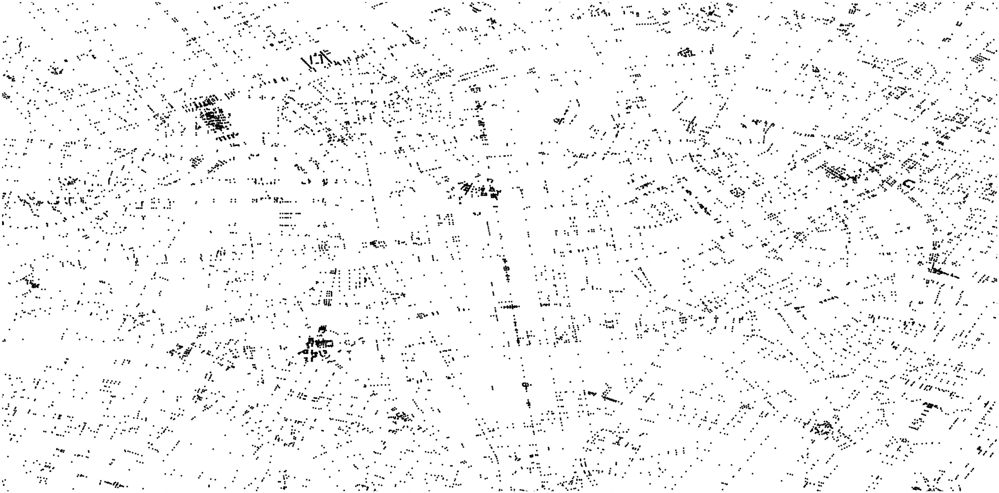

(<Figure size 4283.72x2160 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2bc2eb4d0>)

In [29]:
# Plot Network-Nodes
%matplotlib inline
bbox = [13.353678,52.498607,13.42382,52.533975]

ua.plot.plot_net(nodes=ua_net.net_nodes,
                 edges=ua_net.net_edges,
                 bbox=bbox,
                 fig_height=30, margin=0.02,
                 edge_color='#999999', edge_linewidth=1, edge_alpha=1,
                 node_color='black', node_size=20, node_alpha=0.9, node_edgecolor='black', node_zorder=3, nodes_only=True)

### Integrated network by travel time with average headways


Figure created. Took 283.91 seconds


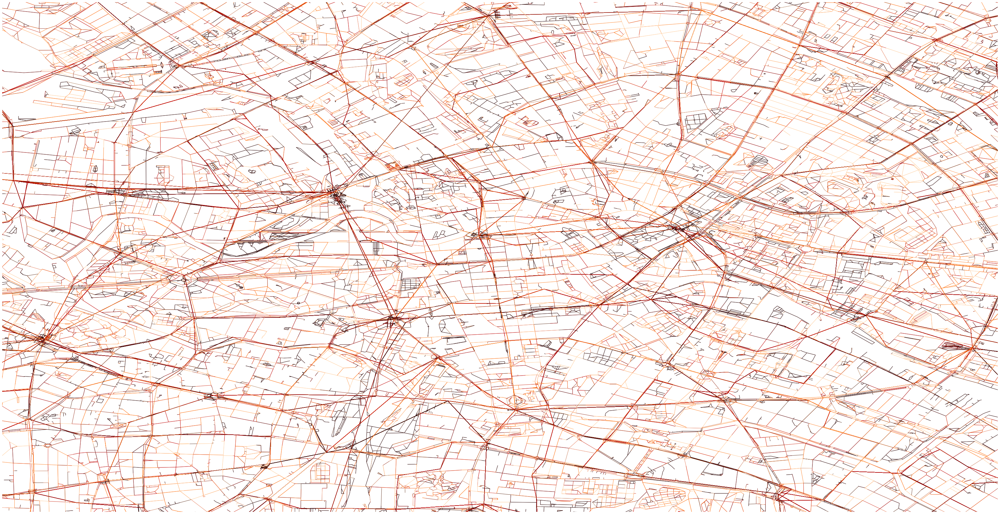

(<Figure size 4109.86x2160 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2c5721d10>)

In [23]:
bbox = (13.324699,52.483276,13.454955,52.551734)
sf_bbox = [bbox[1], bbox[0], bbox[3], bbox[2]]

edgecolor = ua.plot.col_colors(df=ua_net.net_edges, col='weight', cmap='gist_heat_r', num_bins=5)
ua.plot.plot_net(nodes=ua_net.net_nodes,
                 edges=ua_net.net_edges,
                 bbox=bbox,
                 fig_height=30, margin=0.02,
                 edge_color=edgecolor, edge_linewidth=1, edge_alpha=0.7,
                 node_color='black', node_size=0, node_alpha=1, node_edgecolor='none', node_zorder=3, nodes_only=False)

Figure created. Took 295.75 seconds


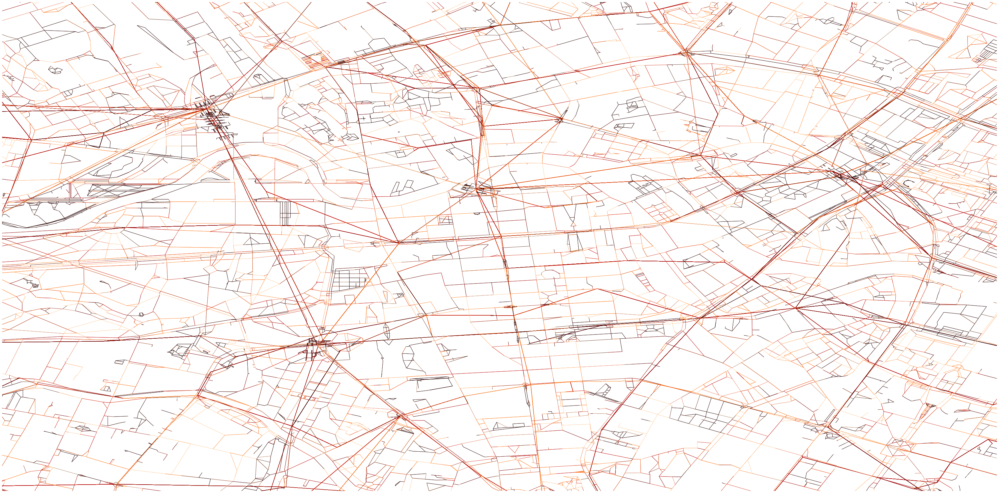

(<Figure size 4283.72x2160 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2bfc929d0>)

In [27]:
# change bbox
bbox = [13.353678,52.498607,13.42382,52.533975]

edgecolor = ua.plot.col_colors(df=ua_net.net_edges, col='weight', cmap='gist_heat_r', num_bins=5)
ua.plot.plot_net(nodes=ua_net.net_nodes,
                 edges=ua_net.net_edges,
                 bbox=bbox,
                 fig_height=30, margin=0.02,
                 edge_color=edgecolor, edge_linewidth=1, edge_alpha=0.7,
                 node_color='black', node_size=0, node_alpha=1, node_edgecolor='none', 
                 node_zorder=3, nodes_only=False)

Figure created. Took 297.93 seconds


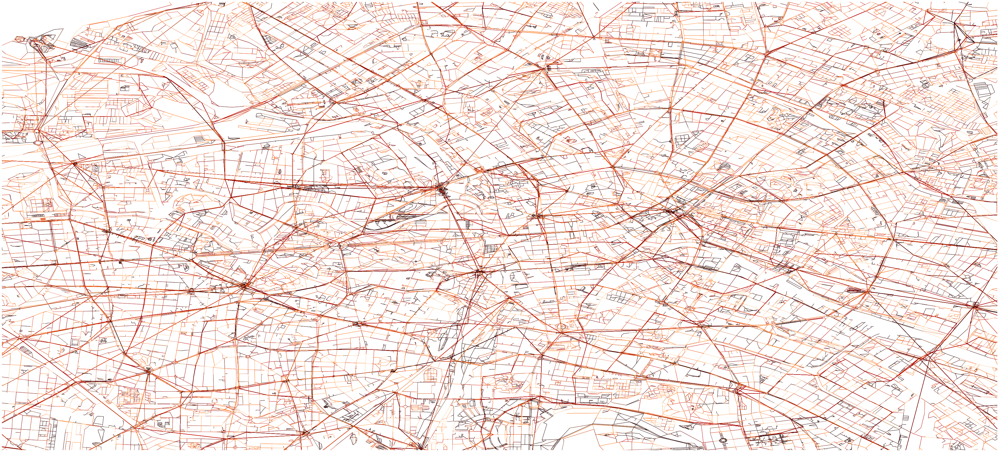

(<Figure size 4669.03x2160 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x2ba249a10>)

In [28]:
# change bbox again
bbox = [13.283024,52.473429,13.477383,52.563344]
edgecolor = ua.plot.col_colors(df=ua_net.net_edges, col='weight', cmap='gist_heat_r', num_bins=5)
ua.plot.plot_net(nodes=ua_net.net_nodes,
                 edges=ua_net.net_edges,
                 bbox=bbox,
                 fig_height=30, margin=0.02,
                 edge_color=edgecolor, edge_linewidth=1, edge_alpha=0.7,
                 node_color='black', node_size=0, node_alpha=1, node_edgecolor='none', 
                 node_zorder=3, nodes_only=False)